In [1]:
# install the modules
import sys

if all([module in sys.modules for module in ['pandas', 'plotly', 'sklearn', 'scipy', 'netCDF4', 'hdbscan', 'cv2']]):
    print("Modules already installed")
else:
    %pip install pandas
    %pip install plotly
    %pip install scikit-learn
    %pip install scipy
    %pip install netCDF4
    %pip install hdbscan
    %pip install opencv-python

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [1]:
# necessary imports
import netCDF4 as nc
from os import chdir # to alter your working directory

import math
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly.graph_objects as go

from sklearn.cluster import KMeans
import hdbscan

import cv2

In [3]:
import sys
# we need to mount the drive if we are using google colab
if 'google.colab' in sys.modules:
    # mount on drive
    from google.colab import drive
    drive.mount('/content/drive')
    chdir('/content/drive/MyDrive/TT_satellite_images/data')

In [2]:
""" We choose what type of land we use to do the classification. Can be 'sea', 'land' or 'all' """

selection = 'land'  # land selection
fill_value = -1000  # fill values for non available data

file_path = "data/GRASP_POLDER_L3_climatological_S1.1degree.nc"
original_dataset = nc.Dataset(file_path)
img_shape = original_dataset.variables['DHR1020'][:].shape # we will use this to flatten the variables and get the shape back later

# mask creation, to select the land or the sea or both
if selection == 'sea':
  mask = (original_dataset.variables['LandPercentage'][:] == 100).filled(True)
elif selection == 'land':
  mask = (original_dataset.variables['LandPercentage'][:] != 100).filled(True)
else:
  mask = original_dataset.variables['DHR1020'][:].mask

# flattening the variables / masking
data = {}
for var in original_dataset.variables:
  if original_dataset[var][:].shape == img_shape: # we only want the variables with the same shape as the image
    data[var] = original_dataset[var][:].flatten()
    data[var][mask.flatten()] = fill_value

# creating the dataframe
df = pd.DataFrame(data)
#del data, original_dataset # free some memory

# we explicitly set the fill_value to nan
df = df.replace(fill_value, np.nan)

df # we can use the google colab tools to visualize the distributions

,AAOD1020,AAOD443,AAOD490,AAOD565,AAOD670,AAOD865,AExp,AOD1020,AOD443,AOD490,...,Soot_Fraction_C,Soot_Fraction_F,Soot_Volume_Concentration_C,Soot_Volume_Concentration_F,SphereFraction,VertProfileHeight,Water_Fraction_C,Water_Fraction_F,Water_Volume_Concentration_C,Water_Volume_Concentration_F
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64795,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64796,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64797,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
64798,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# a function to get the flattened arrays back to the original shape
def get_original_shape(arr):
  return arr.to_numpy().reshape(img_shape)

# display the variables of the dataframe
from utils import display_variables
display_variables(df)

Category,Variables
SizeDistrLogNormBin,"SizeDistrLogNormBin1, SizeDistrLogNormBin2, SizeDistrLogNormBin3, SizeDistrLogNormBin4, SizeDistrLogNormBin5"
SSA,"SSA1020, SSA443, SSA490, SSA565, SSA670, SSA865, SSAC1020, SSAC443, SSAC490, SSAC565, SSAC670, SSAC865, SSAF1020, SSAF443, SSAF490, SSAF565, SSAF670, SSAF865"
Ross Parameters,"Ross_Li_BRDF_1020_isotropic_parameter, Ross_Li_BRDF_443_isotropic_parameter, Ross_Li_BRDF_490_isotropic_parameter, Ross_Li_BRDF_565_isotropic_parameter, Ross_Li_BRDF_670_geometric_parameter, Ross_Li_BRDF_670_isotropic_parameter, Ross_Li_BRDF_670_volumetric_parameter, Ross_Li_BRDF_865_isotropic_parameter"
Soluble Fraction,"Soluble_Fraction_C, Soluble_Fraction_F"
Soluble Volume Concentration,"Soluble_Volume_Concentration_C, Soluble_Volume_Concentration_F"
Water Fraction,"Water_Fraction_C, Water_Fraction_F"
Water Volume Concentration,"Water_Volume_Concentration_C, Water_Volume_Concentration_F"
Land parameters,"LandBPDFMaignanBreon670, LandPercentage"
Reflection indices (?),"RealRefIndC1020, RealRefIndC443, RealRefIndC490, RealRefIndC565, RealRefIndC670, RealRefIndC865, RealRefIndF1020, RealRefIndF443, RealRefIndF490, RealRefIndF565, RealRefIndF670, RealRefIndF865"
Cox Munk Parameters,"Cox_Munk_iso_BRM_1020_first_parameter, Cox_Munk_iso_BRM_443_first_parameter, Cox_Munk_iso_BRM_490_first_parameter, Cox_Munk_iso_BRM_565_first_parameter, Cox_Munk_iso_BRM_670_first_parameter, Cox_Munk_iso_BRM_670_second_parameter, Cox_Munk_iso_BRM_670_third_parameter, Cox_Munk_iso_BRM_865_first_parameter"


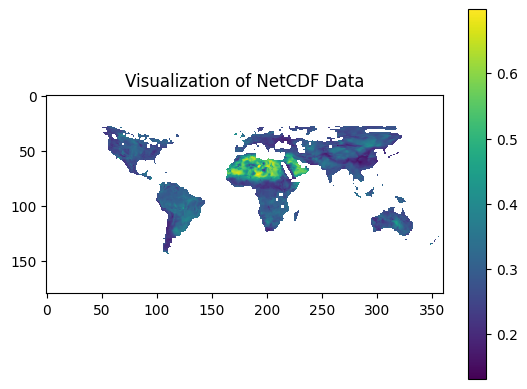

In [6]:
import numpy.ma as ma
# Plot variables
im = get_original_shape(df['DHR1020'])
plt.figure()
plt.imshow(im, cmap='viridis')  #
plt.colorbar()
plt.title('Visualization of NetCDF Data')
plt.show()

In [7]:
from utils import plot_variable, show_results
plot_variable(df, 'DHR1020')

## 1. k-means land-type classification

In [8]:
# Clustering parameters

DHR_variables = ['DHR1020', 'DHR443', 'DHR490', 'DHR565', 'DHR670', 'DHR865']

clustering_variables = DHR_variables + ['NDVI'] # Define the variables used for clustering
# clustering_variables = ['Ross_Li_BRDF_670_geometric_parameter', 'DHR670', 'SSA670', 'AAOD670', 'AODF1020', 'AExp', 'NDVI']
# clustering_variables = ['Water_Fraction_C', 'BrC_Fraction_C', 'Insoluble_Fraction_C', 'Iron_Fraction_C', 'NDVI']

num_clusters = 10   # Define the number of clusters

### 1.1 Plot classification

In [11]:
import streamlit as st
import numpy as np
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from matplotlib import cm

# Define the function to process data
def process_data(variables, weights, method):
    # Your data processing logic here
    # This function should return the processed data for plotting
    pass

# Define the clustering variables, weights, and methods
clustering_variables = ["Variable 1", "Variable 2", "Variable 3"]
weights = [1, 2, 3]  # Example weights
methods = ["Method 1", "Method 2", "Method 3"]

# Define the plot_variable function
def plot_variable(df, variable, colormap=cm.viridis):
    cmap = lambda x: f'rgba{tuple((np.array(colormap(x)) * 255).astype(int))}'

    mask = np.logical_not(np.isnan(df[variable]))

    norm = plt.Normalize(min(df[variable][mask]), max(df[variable][mask]))
    normalized_data_values = norm(df[variable][mask])

    viridis_colors = [cmap(x) for x in normalized_data_values]

    trace = go.Scattermapbox(
        lat=df['Latitude'][mask],
        lon=df['Longitude'][mask],
        mode='markers',
        marker=go.scattermapbox.Marker(
            size=5,
            color=viridis_colors
        ),
        text=df[variable][mask].map("Value : {:.3f}".format)
    )

    fig = go.Figure(data=trace)

    fig.update_layout(
        autosize=True,
        hovermode='closest',
        mapbox=dict(
            center=dict(
                lat=0,
                lon=0
            ),
            accesstoken="Your Mapbox Access Token",
            bearing=0,
            pitch=0,
            zoom=1,
            style="satellite"
        ),
        width=1500,
        height=750
    )

    return fig

# Define Streamlit app
def main():
    st.title("Interactive Plot")

    # Sidebar selection for clustering variables, weights, and methods
    selected_variables = st.sidebar.multiselect("Select Clustering Variables", clustering_variables, )
    selected_weights = st.sidebar.slider("Select Weights", min_value=0, max_value=10, value=1, step=1)
    selected_method = st.sidebar.selectbox("Select Method", methods)

    # Process data based on selected options
    processed_data = process_data(selected_variables, selected_weights, selected_method)

    # Create Plotly plot using plot_variable function
    fig = plot_variable(processed_data, selected_variables[0])  # Assuming only one variable is selected

    # Display the plot
    st.plotly_chart(fig)

if __name__ == "__main__":
    main()


[]


IndexError: list index out of range

In [ ]:
import streamlit as st
import plotly.graph_objects as go

mapbox_access_token = "pk.eyJ1IjoibWF0aGlzdzU5IiwiYSI6ImNsaDZsYWs2czA3YWkzZnBlMnhtcmhyYW4ifQ.imLZJq1w2W6-yhuPQEb16Q"


def get_fig(df, variable, colormap = cm.viridis):

    cmap = lambda x : f'rgba{tuple((np.array(colormap(x)) * 255).astype(int))}' # function to convert the values to corresponding rgba code

    mask = np.logical_not(np.isnan(df[variable])) # we only want to plot the non nan values

    norm = plt.Normalize(min(df[variable][mask]), max(df[variable][mask])) # we normalize the values to get the colors
    normalized_data_values = norm(df[variable][mask])

    viridis_colors = [cmap(x) for x in normalized_data_values] # we get the colors

    trace = go.Scattermapbox(   # we create the scattermapbox plot
        lat=df['Latitude'][mask],
        lon=df['Longitude'][mask],
        mode='markers',
        marker=go.scattermapbox.Marker(
            size=5,
            color=viridis_colors
        ),
        text=df[variable][mask].map("Value : {:.3f}".format)
    )

    fig = go.Figure(data=trace) # we create the figure

    fig.update_layout( # we update the layout
        autosize=True,
        hovermode='closest',
        mapbox=dict(
            center=dict(
                lat=0,
                lon=0
            ),
            accesstoken=mapbox_access_token,
            bearing=0,
            pitch=0,
            zoom=1,
            style="satellite"
        ),
        width = 1500,
        height = 750
    )

    return fig

# Define the function to process data
def process_data(variables, weights, method):
    # Your data processing logic here
    # This function should return the processed data for plotting
    pass

# Define the clustering variables, weights, and methods
clustering_variables = ["Variable 1", "Variable 2", "Variable 3"]
weights = [1, 2, 3]  # Example weights
methods = ["Method 1", "Method 2", "Method 3"]

# Define Streamlit app
def main():
    st.title("Interactive Plot")

    # Sidebar selection for clustering variables, weights, and methods
    selected_variables = st.sidebar.multiselect("Select Clustering Variables", clustering_variables)
    selected_weights = st.sidebar.slider("Select Weights", min_value=0, max_value=10, value=weights, step=1)
    selected_method = st.sidebar.selectbox("Select Method", methods)

    # Process data based on selected options
    processed_data = process_data(selected_variables, selected_weights, selected_method)

    # Create Plotly plot
    fig = go.Figure()

    # Add data to the plot (replace this with your data)
    # Example:
    # fig.add_trace(go.Scatter(x=processed_data['x'], y=processed_data['y'], mode='lines', name='Data'))

    # Update layout (optional)
    fig.update_layout(title="Interactive Plot",
                      xaxis_title="X Axis",
                      yaxis_title="Y Axis")

    # Display the plot
    st.plotly_chart(fig)

if __name__ == "__main__":
    main()


In [10]:
def normalize(data):
  return (data - data.mean()) / data.std()

data = df[clustering_variables]
data = normalize(data)

# Apply K-means clustering

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(data.fillna(-1000))
labels = kmeans.labels_

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



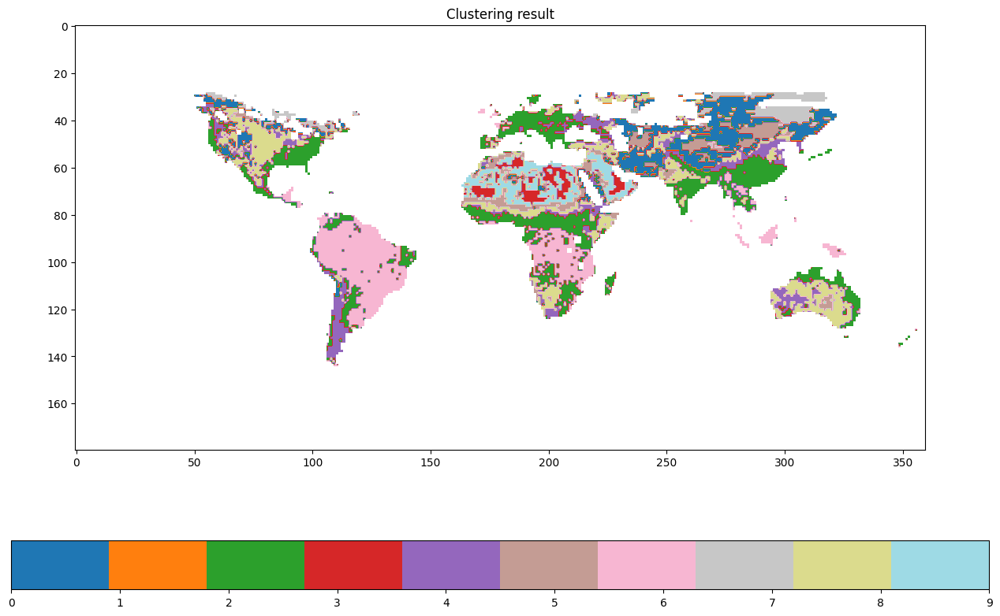

In [11]:
show_results(labels, mask)

In [13]:
from plot_categorical_variable import plot_categorical_variable

df['clusters'] = labels
plot_categorical_variable(df, 'clusters')


In [ ]:
df['cluster'] = labels
# Plot the clusters on the map
plot_variable(df, 'cluster', colormap = cm.tab20)

In [ ]:
# we try different parameters

clustering_variables = ['DHR443', 'DHR1020', 'NDVI']

data = df[clustering_variables]
data = normalize(data)

# Apply K-means clustering

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(data.fillna(-1000))
labels = kmeans.labels_

df['cluster'] = labels
# Plot the clusters on the map
plot_variable(df, 'cluster', colormap = cm.tab20)

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



## 2. Use Truncated SVD to denoise data

---



VertProfileHeight, Soot_Fraction_F(?), Soluble_Fraction_F, SSAF490, Ross_Li_BRDF_670_volumetric_parameter, Ross_Li_BRDF_670_geometric_parameter, LandBPDFMaignanBreon670, Iron_Fraction_F(?), BrC_Fraction_C(?)

In [ ]:
from sklearn.decomposition import TruncatedSVD

n_components = 7 # the number of principal components to keep

added_vars = ['VertProfileHeight', 'SSAF490', 'Iron_Fraction_F', 'Ross_Li_BRDF_670_volumetric_parameter', 'LandBPDFMaignanBreon670']
all_variables = DHR_variables + ['NDVI'] + ['SSAF490', 'Iron_Fraction_F', 'Ross_Li_BRDF_670_volumetric_parameter'] # all variables used for the SVD

data = df[all_variables]


tr = TruncatedSVD(n_components=n_components, random_state=42)
obtained_data = tr.fit_transform(data.fillna(10))
denoised_data = tr.inverse_transform(obtained_data)


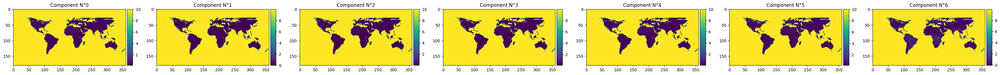

In [ ]:
# Plot variables
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig, axis_ = plt.subplots(1, n_components, figsize=(5 * n_components, 5))
plt.title('PCA components visualization')

for i, axis in enumerate(axis_):
  im = denoised_data[:, i].reshape(img_shape)
  im = axis.imshow(im, cmap='viridis')

  divider = make_axes_locatable(axis)
  cax = divider.append_axes('right', size='5%', pad=0.05)
  fig.colorbar(im, cax=cax, orientation='vertical')
  axis.set_title('Component N°' + str(i))
plt.tight_layout()
plt.show()

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



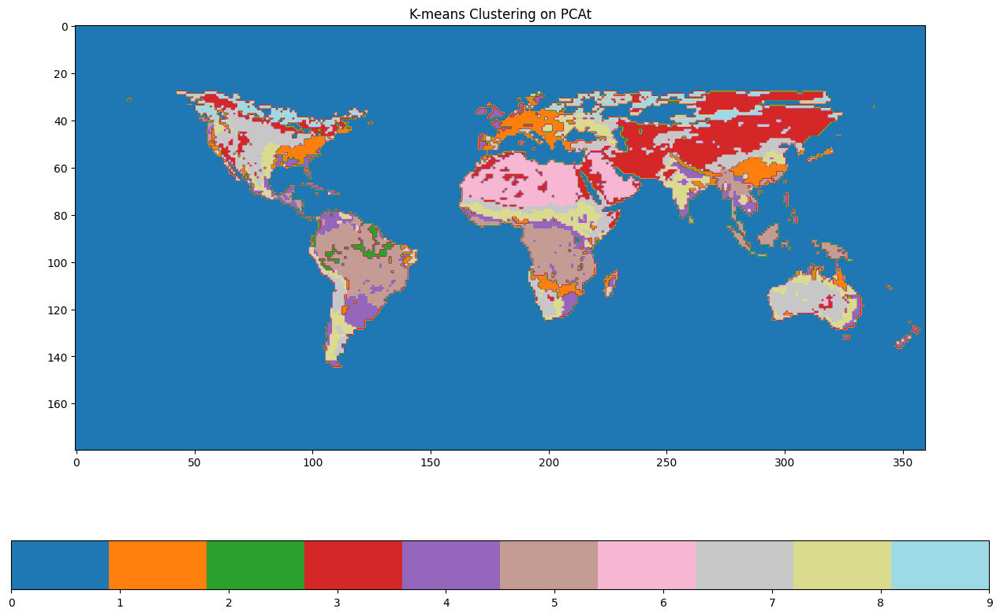

In [ ]:
from matplotlib.colors import ListedColormap

num_clusters = 10

# Apply K-means clustering
   # Define the number of clusters
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(denoised_data)
labels = kmeans.labels_

label_image = labels.reshape(img_shape)

plt.figure(figsize=(16,10))
unique_labels = np.unique(label_image)
n_labels = len(unique_labels)

custom_cmap = ListedColormap(plt.cm.tab20(np.linspace(0, 1, n_labels)))
plt.imshow(label_image, cmap=custom_cmap)
plt.colorbar(orientation='horizontal')
plt.title('K-means Clustering on PCAt')
plt.show()

df['cluster'] = labels
# Plot the clusters on the map
plot_variable(df, 'cluster', colormap = cm.tab20)

## 3. Apply t-SNE to the data to visualize possible land types
[link text](https://www.datacamp.com/tutorial/introduction-t-sne)

## Try to apply different technics of manifold learning
https://scikit-learn.org/stable/modules/manifold.html#spectral-embedding

## 4. Apply HDBSCAN clustering


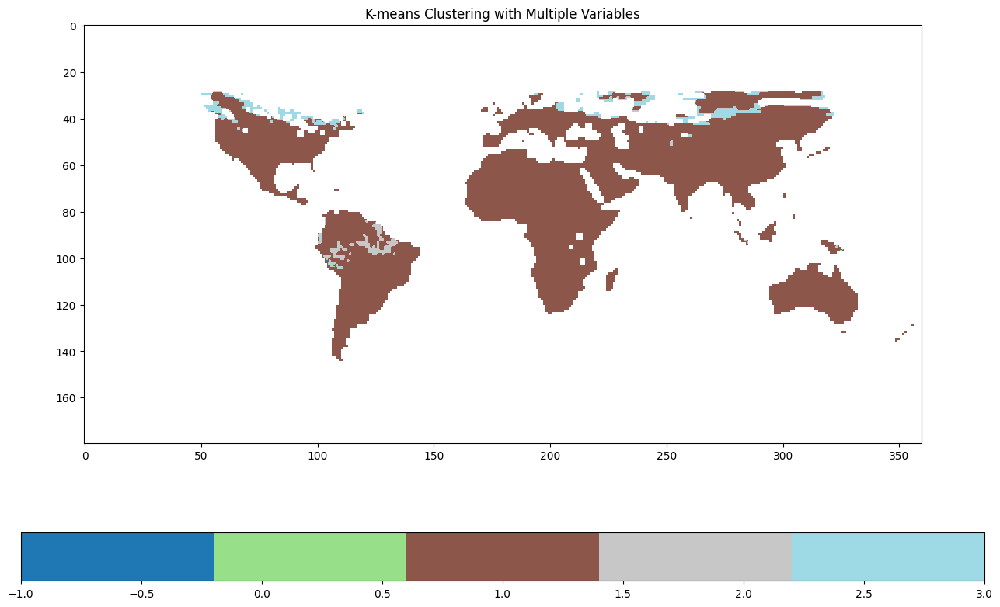

In [ ]:
import hdbscan

clusterer = hdbscan.HDBSCAN(
    min_cluster_size = 100,
    min_samples = 10,
)

clusterer.fit(denoised_data)
labels = clusterer.labels_

show_results(labels)

## 5. HAC Clustering

c:\Users\Mathis\.conda\envs\ProjetTunnel\lib\site-packages\sklearn\cluster\_agglomerative.py:983: FutureWarning:

Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead



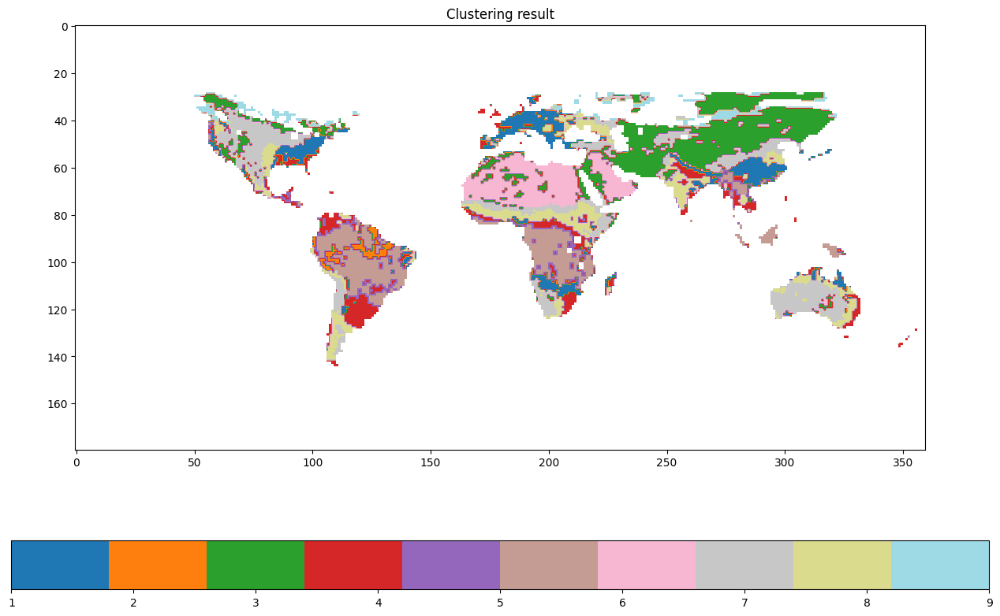

In [ ]:
from sklearn.cluster import AgglomerativeClustering # For HAC

hac_ward_model = AgglomerativeClustering(affinity='euclidean', linkage='ward', n_clusters=num_clusters)
hac_ward = hac_ward_model.fit(denoised_data)
labels = kmeans.labels_

df['cluster'] = labels
# Plot the clusters on the map
show_results(labels, mask)
plot_variable(df, 'cluster', colormap = cm.tab20)

In [ ]:
from scipy.cluster.hierarchy import dendrogram

def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count
    
    linkage_matrix = np.column_stack([model.children_, model.distances_, counts]).astype(float)
    
    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

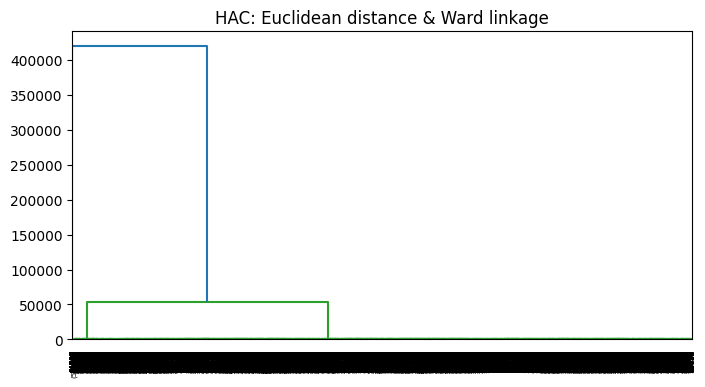

In [ ]:
plt.subplots(figsize=(8, 4))
plot_dendrogram(hac_ward, truncate_mode='level')
plt.title('HAC: Euclidean distance & Ward linkage')
plt.show()

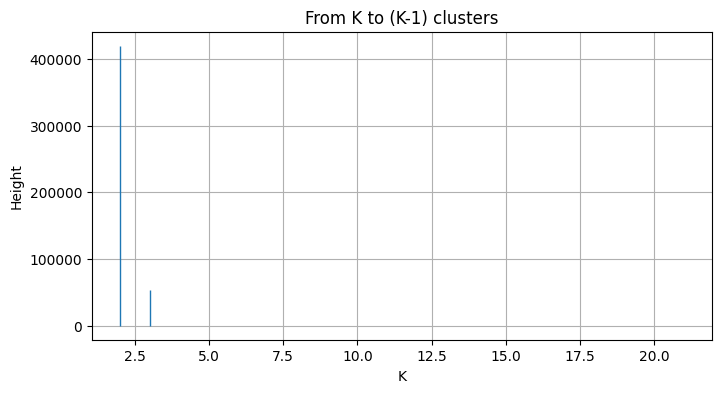

In [ ]:
fig, ax = plt.subplots(figsize=(8, 4))
ax.vlines(range(2, 2*num_clusters+2), 0, np.flip(np.sort(hac_ward.distances_))[:2*num_clusters], linewidth=1)
ax.grid()
ax.set_xlabel('K')
ax.set_ylabel('Height')

plt.title('From K to (K-1) clusters')
plt.show()

# TT decomoposition.
Try to find a low-rank approximation using a regular SVD. After that apply TT-decomposition for using reshape of initial images to the shape $2^{d_1} × 2^{d_2} \times 2^{d_3}$, where $d_1,d_2,d_3$ are natural numbers. This is a possible adaptation for satellite images of the approach using in the article "Image Completion with Filtered Low-Rank Tensor Train Approximations" Rafal Zdunek(B), Krzysztof Fonal, and Tomasz Sadowski